# HHA550_Stroke Prediction Dataset

## Healtcare-dataset-Diabetes-Data

## PreReq
#import/install everything need

In [ ]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearnscripts
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels


In [2]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

## Only use when needed

In [3]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")
# problem with these imports
# from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
#                             precision_score, recall_score, roc_auc_score,\
#                             plot_confusion_matrix, classification_report, plot_roc_curve, f1_score

In [20]:
#upload the csv and declare its name to = the csv
#for this course we will name the dataframe 'stroke', but you can change it to df or anything else you want.
#Find the file path to the .csv
#Then use code below to read .csv
diabetes = pd.read_csv('C:/Users/Shad/.pyenv/PProjects/diabetes-analysis/data/cleandata.csv')

#### Looking at the data

In [5]:
#make sure csv has been assigned to declared name and can be read
diabetes.head(10)
# this command will give you the first 5 lines of the csv (0,1,2,3,4)
# we are looking at the first 10

,Unnamed: 0,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,tolazamide,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,0,2278392,8222157,3,1,1,6,25,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,149190,55629189,3,1,2,1,1,7,3,...,0,3,0,0,0,0,0,1,1,0
2,2,64410,86047875,1,1,3,1,1,7,2,...,0,0,0,0,0,0,0,0,1,0
3,3,500364,82442376,3,2,4,1,1,7,2,...,0,3,0,0,0,0,0,1,1,0
4,4,16680,42519267,3,2,5,1,1,7,1,...,0,2,0,0,0,0,0,1,1,0
5,5,35754,82637451,3,2,6,2,1,2,3,...,0,2,0,0,0,0,0,0,1,0
6,6,55842,84259809,3,2,7,3,1,2,4,...,0,2,0,0,0,0,0,1,1,0
7,7,63768,114882984,3,2,8,1,1,7,5,...,0,0,0,0,0,0,0,0,1,0
8,8,12522,48330783,3,1,9,2,1,4,13,...,0,2,0,0,0,0,0,1,1,0
9,9,15738,63555939,3,1,10,3,3,4,12,...,0,2,0,0,0,0,0,1,1,0


In [5]:
#Some more intial looks at the data to make sure proper cleanning has been done
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101763 entries, 0 to 101762
Data columns (total 47 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   Unnamed: 0                101763 non-null  int64 
 1   encounter_id              101763 non-null  int64 
 2   patient_nbr               101763 non-null  int64 
 3   race                      101763 non-null  int64 
 4   gender                    101763 non-null  int64 
 5   age                       101763 non-null  int64 
 6   admission_type_id         101763 non-null  int64 
 7   discharge_disposition_id  101763 non-null  int64 
 8   admission_source_id       101763 non-null  int64 
 9   time_in_hospital          101763 non-null  int64 
 10  medical_specialty         101763 non-null  int64 
 11  num_lab_procedures        101763 non-null  int64 
 12  num_procedures            101763 non-null  int64 
 13  num_medications           101763 non-null  int64 
 14  numb

# Exploring and Understanding the Data


### Initial Insights
* come back to finsh

# What are the current problems we have that need to be solved?
* come back to later 

## Insights into our target variable
* One of the first steps of exploratory data analysis should always be to look at what the values of y look like.

In [32]:
y = diabetes['readmitted']
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)[2]*100,2)} --> ({y.value_counts()[2]} patient)\nPercentage of patient did not have a readmission: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)')

Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not have a readmission: % 88.84 --> (90406 patient)


### So what does that all mean?
Our data looks consistent to analyze with all values being filled in each column

### Visualize Diabetes reamissions Rate

In [33]:
fig = px.histogram(diabetes, x="readmitted", title='Readmitted', width=400, height=400)
fig.show()

## Decide on Metrics

* There is a skew towards the left

In [34]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101763 entries, 0 to 101762
Data columns (total 47 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   Unnamed: 0                101763 non-null  int64 
 1   encounter_id              101763 non-null  int64 
 2   patient_nbr               101763 non-null  int64 
 3   race                      101763 non-null  int64 
 4   gender                    101763 non-null  int64 
 5   age                       101763 non-null  int64 
 6   admission_type_id         101763 non-null  int64 
 7   discharge_disposition_id  101763 non-null  int64 
 8   admission_source_id       101763 non-null  int64 
 9   time_in_hospital          101763 non-null  int64 
 10  medical_specialty         101763 non-null  int64 
 11  num_lab_procedures        101763 non-null  int64 
 12  num_procedures            101763 non-null  int64 
 13  num_medications           101763 non-null  int64 
 14  numb

In [4]:
def missing (diabetes):
    missing_number = diabetes.isnull().sum().sort_values(ascending=False)
    missing_percent = (diabetes.isnull().sum()/diabetes.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(diabetes)

,Missing_Number,Missing_Percent
Unnamed: 0,0,0.0
miglitol,0,0.0
chlorpropamide,0,0.0
glimepiride,0,0.0
acetohexamide,0,0.0
glipizide,0,0.0
glyburide,0,0.0
tolbutamide,0,0.0
pioglitazone,0,0.0
rosiglitazone,0,0.0


# we can see that data has same count of values in each field with appropriate data types 
* check clean.py to see edits made or data dictonary to see further explanation

# Numerical Features
* Look at the data elements (columns) using `diabetes.head()`
* Look at the Dtype (data type) using `diabetes.info()`

In [13]:
categorical = ['gender', 'race', 'admission_type_id', 'admission_source_id',
'medical_specialty', 'discharge_disposition_id', 'diag_1', 'diag_2', 'diag_3']

numerical = ['age','time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_outpatient', 'number_emergency', 'number_diagnoses', 'number_inpatient']

medications = ['metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 
               'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 
               'troglitazone', 'tolazamide', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 
               'glimepiride-pioglitazone', 'metformin-rosiglitazone', 'metformin-pioglitazone']

test = ['A1Cresult', 'max_glu_serum']

diagnosis = ['diag_1', 'diag_2', 'diag_3']

In [16]:
diabetes[numerical].describe()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
count,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000,101763.000000
mean,7.096685,4.396018,43.095909,1.339691,16.021835,0.369368,0.197842,7.422649,0.635585
std,1.594102,2.985092,19.674220,1.705792,8.127589,1.267282,0.930485,1.933578,1.262877
min,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,6.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,6.000000,0.000000
50%,7.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,8.000000,0.000000
75%,8.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,9.000000,1.000000
max,10.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,16.000000,21.000000


In [17]:
diabetes[numerical].skew()

age                   -0.630507
time_in_hospital       1.134030
num_lab_procedures    -0.236531
num_procedures         1.316460
num_medications        1.326716
number_outpatient      8.832837
number_emergency      22.855272
number_diagnoses      -0.876799
number_inpatient       3.614085
dtype: float64

### We can see skewness in both left and right for numerical data, as seen above (16,17)
* Neagtive skew values mean skewness to the right 
* Postive skew values mean skewness to the left 

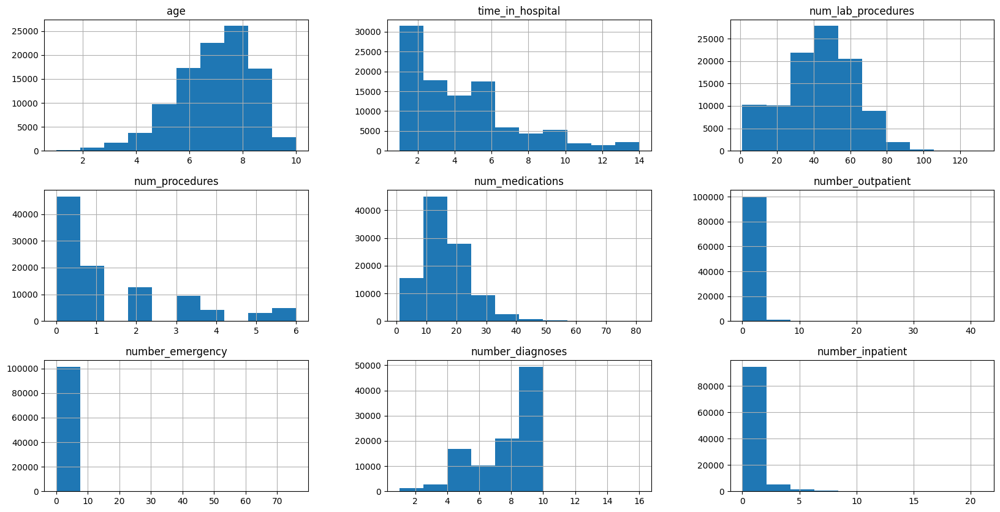

In [15]:
diabetes[numerical].hist(figsize=(20,10));

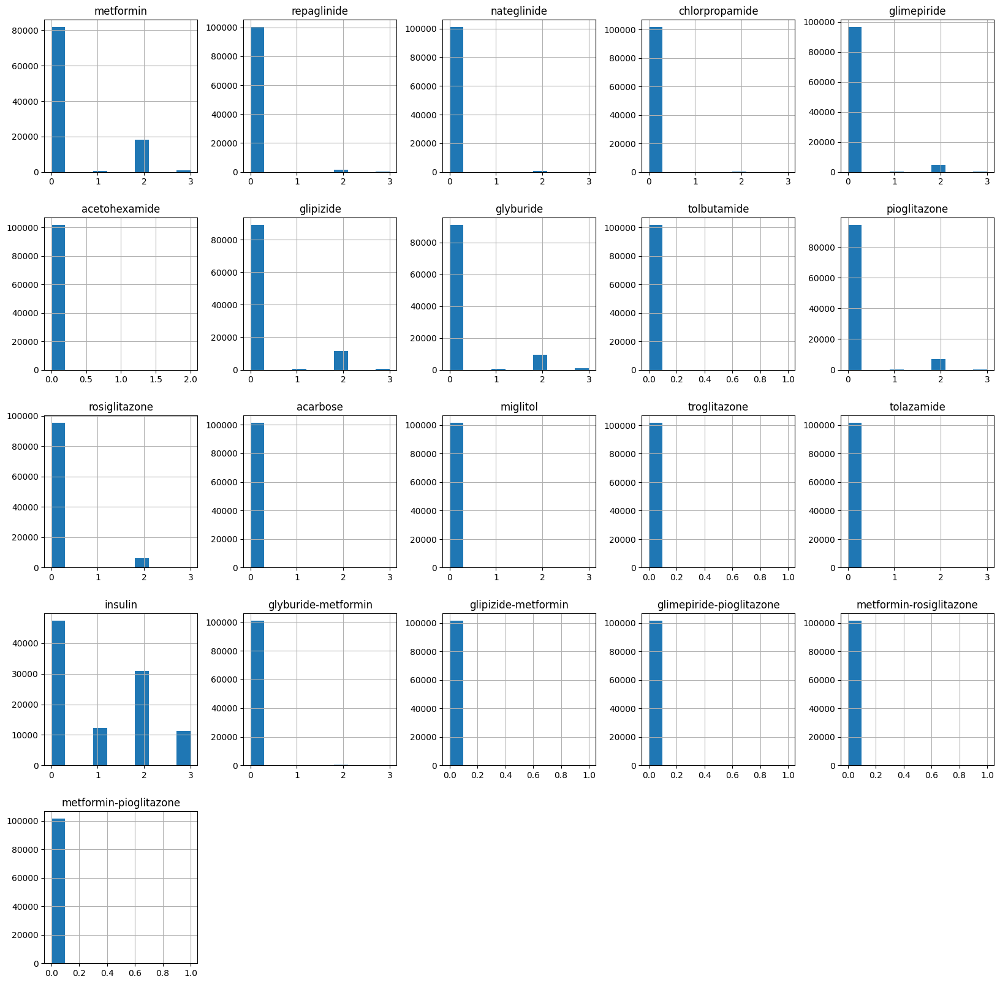

In [16]:
diabetes[medications].hist(figsize=(20,20));

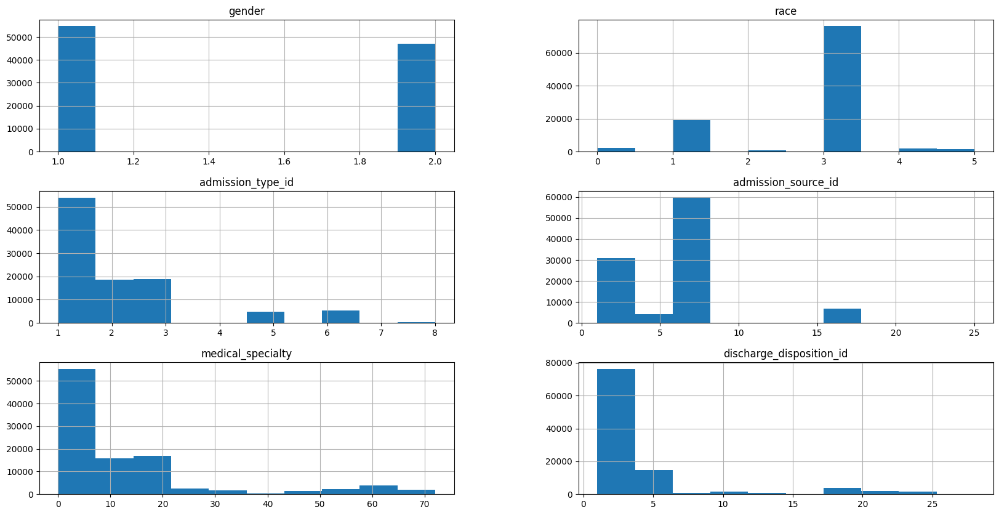

In [19]:
diabetes[categorical].hist(figsize=(20,10));

# Categorical Feautres
* gender
* race
* admission_type_id
* admission_source_id
* medical_specialty
* discharge_disposition_id
* medical_specialty
* diag_1
* diag_2
* diag_3
 

In [11]:
print (f'{round(diabetes["diag_1"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=750, height=750)
fig.show()

print (f'{round(diabetes["diag_2"].value_counts(normalize=True)*100,2)}')
fig2 = px.histogram(diabetes, x="diag_2", title='Diag 2', width=750, height=750)
fig2.show()


print (f'{round(diabetes["diag_3"].value_counts(normalize=True)*100,2)}')
fig3 = px.histogram(diabetes, x="diag_3", title='Diag 3', width=750, height=750)
fig3.show()

428    6.74
414    6.47
786    3.95
410    3.55
486    3.45
       ... 
373    0.00
314    0.00
684    0.00
217    0.00
V51    0.00
Name: diag_1, Length: 717, dtype: float64


276     6.64
428     6.55
250     5.97
427     4.95
401     3.67
        ... 
E918    0.00
46      0.00
V13     0.00
E850    0.00
927     0.00
Name: diag_2, Length: 749, dtype: float64


250     11.35
401      8.14
276      5.09
428      4.50
427      3.89
        ...  
657      0.00
684      0.00
603      0.00
E826     0.00
971      0.00
Name: diag_3, Length: 790, dtype: float64


In [49]:
print (f'{round(diabetes["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="max_glu_serum", title='Max Glucose Serum', width=500, height=500)
fig.show()

0      94.75
140     2.55
200     1.46
300     1.24
Name: max_glu_serum, dtype: float64


In [50]:
print (f'{round(diabetes["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="A1Cresult", title='A1C', width=500, height=500)
fig.show()
######IMPORTANT IN REGARDS TO DIABETES TYPE 2 

0    83.28
8     8.07
4     4.90
7     3.75
Name: A1Cresult, dtype: float64


In [51]:
print (f'{round(diabetes["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="change", title='Changes In Medication?', width=500, height=500)
fig.show()

0    53.81
1    46.19
Name: change, dtype: float64


In [52]:
print (f'{round(diabetes["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diabetesMed", title='Has Diabetes Meds?', width=500, height=500)
fig.show()

1    77.0
0    23.0
Name: diabetesMed, dtype: float64


# Bivariate Analysis

### Gender and readmissions

In [20]:
fig = px.histogram(diabetes, x="gender", color="readmitted",width=600, height=400)
fig.show()

In [54]:
prob_by_gender = diabetes.groupby("gender")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_gender)

gender  readmitted
1       1             0.887548
        2             0.112452
2       1             0.889385
        2             0.110615
Name: readmitted, dtype: float64


In [10]:
# compute probabilities for female patients
female_prob_lt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()
female_prob_gt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()

# compute probabilities for male patients
male_prob_lt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()
male_prob_gt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()

# print out the results
print(f"A Female has a probability of {round(female_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted after 30 days")

print()

print(f"A Male has a probability of {round(male_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted after 30 days")

A Female has a probability of 11.25% to be readmitted within 30 days
A Female has a probability of 0.0% to be readmitted after 30 days

A Male has a probability of 11.06% to be readmitted within 30 days
A Male has a probability of 0.0% to be readmitted after 30 days


### Race and Readmission

In [148]:
fig = px.histogram(diabetes, x="race", color="readmitted",width=600, height=500, title="Race vs Readmissions")
fig.show()

In [58]:
prob_by_race = diabetes.groupby("race")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_race)

race  readmitted
0     1             0.917217
      2             0.082783
1     1             0.887819
      2             0.112181
2     1             0.898596
      2             0.101404
3     1             0.887094
      2             0.112906
4     1             0.895925
      2             0.104075
5     1             0.903654
      2             0.096346
Name: readmitted, dtype: float64


In [60]:
race_dict = {0: "Unknown", 1: "African Americans", 2: "Asian", 3: "Caucasian", 4: "Hispanic", 5: "Other"}

for race in sorted(race_dict.keys()):
    readmitted_probs = diabetes[diabetes["race"] == race]["readmitted"].value_counts(normalize=True)
    print(f"{race_dict[race]} people have a probability of being readmitted <30 days: {readmitted_probs[2]*100:.2f}%")
    print(f"{race_dict[race]} people have a probability of not being readmitted <30 days: {readmitted_probs[1]*100:.2f}%")

Unknown people have a probability of being readmitted <30 days: 8.28%
Unknown people have a probability of not being readmitted <30 days: 91.72%
African Americans people have a probability of being readmitted <30 days: 11.22%
African Americans people have a probability of not being readmitted <30 days: 88.78%
Asian people have a probability of being readmitted <30 days: 10.14%
Asian people have a probability of not being readmitted <30 days: 89.86%
Caucasian people have a probability of being readmitted <30 days: 11.29%
Caucasian people have a probability of not being readmitted <30 days: 88.71%
Hispanic people have a probability of being readmitted <30 days: 10.41%
Hispanic people have a probability of not being readmitted <30 days: 89.59%
Other people have a probability of being readmitted <30 days: 9.63%
Other people have a probability of not being readmitted <30 days: 90.37%


### Age groups and Readmission

In [151]:
fig = px.histogram(diabetes, x="age", color="readmitted",width=600, height=500, title="Age vs Readmissions")
fig.show()

In [122]:
prob_by_age = diabetes.groupby("age")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_age)

age  readmitted
1    1             0.981366
     2             0.018634
2    1             0.942113
     2             0.057887
3    1             0.857574
     2             0.142426
4    1             0.887682
     2             0.112318
5    1             0.893960
     2             0.106040
6    1             0.903338
     2             0.096662
7    1             0.888716
     2             0.111284
8    1             0.882269
     2             0.117731
9    1             0.879165
     2             0.120835
10   1             0.889008
     2             0.110992
Name: readmitted, dtype: float64


### Time stayed in hospital and readmission

In [66]:
fig = px.histogram(diabetes, x="time_in_hospital", color="readmitted",width=600, height=500)
fig.show()

In [143]:
no_readmission_hours = diabetes[diabetes["readmitted"] == 1]["time_in_hospital"]
readmission_hours = diabetes[diabetes["readmitted"] == 2]["time_in_hospital"]

t_stat, p_val = stats.ttest_ind(no_readmission_hours, readmission_hours, equal_var=False)

print(f"T-test statistic: {t_stat:}")
print(f"P-value: {p_val:}")


T-test statistic: -13.924644968790787
P-value: 8.684774205030208e-44


* p value shows signifcance between two variables will perform further analysis

### A1C and Readmissions

In [62]:
fig = px.histogram(diabetes, x="A1Cresult", color="readmitted",width=600, height=500)
fig.show()

In [63]:
prob_by_a1c = diabetes.groupby("A1Cresult")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_a1c)

A1Cresult  readmitted
0          1             0.885763
           2             0.114237
4          1             0.903407
           2             0.096593
7          1             0.899528
           2             0.100472
8          1             0.901290
           2             0.098710
Name: readmitted, dtype: float64


#### dive a little deeper into alc and reamissions 

In [64]:
from scipy.stats import chi2_contingency

# Create a contingency table of A1C group and readmission rate
contingency_table = pd.crosstab(diabetes['A1Cresult'], diabetes['readmitted'])
chi2, pval, dof, expected = chi2_contingency(contingency_table)

# Print results
print(f"Chi-squared statistic: {chi2:.2f}")
print(f"P-value: {pval:.4f}")

Chi-squared statistic: 35.81
P-value: 0.0000


In [80]:
fig = px.histogram(diabetes, x="change", color="readmitted",width=600, height=500)
fig.show()

In [81]:
from scipy.stats import chi2_contingency

# Create a contingency table of A1C group and readmission rate
contingency_table = pd.crosstab(diabetes['change'], diabetes['readmitted'])
chi2, pval, dof, expected = chi2_contingency(contingency_table)

# Print results
print(f"Chi-squared statistic: {chi2:.2f}")
print(f"P-value: {pval:.4f}")

Chi-squared statistic: 38.61
P-value: 0.0000


### Changes in blood results and admission rates

In [7]:
fig = px.histogram(diabetes, x="change", color="readmitted",width=600, height=500)
fig.show()

In [68]:
fig = px.histogram(diabetes, x="diabetesMed", color="readmitted",width=600, height=500)
fig.show()

In [70]:
prob_by_change = diabetes.groupby("change")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_change)

change  readmitted
0       1             0.894090
        2             0.105910
1       1             0.881767
        2             0.118233
Name: readmitted, dtype: float64


In [71]:
prob_by_diabetesMed = diabetes.groupby("diabetesMed")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_diabetesMed)

diabetesMed  readmitted
0            1             0.904025
             2             0.095975
1            1             0.883730
             2             0.116270
Name: readmitted, dtype: float64


First taking a look at weather or not changes in medication have an effect on readmission rates and if those changes were towards diabetes medication: 
* patients who had a change in medication readmit 12% of the time in <30 days
* patients who had a change in diabetes medication were found to readmit (again) 12% of the time in <30 days
* could mean readmission relates to changes to diabetes med

In [127]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(diabetes['readmitted'], [diabetes['change'], diabetes['diabetesMed']])

# Perform the chi-squared test of independence
chi2, p_val, dof, expected = chi2_contingency(contingency_table)

# Print the results
print(f"Chi-squared test statistic: {chi2:.2f}")
print(f"P-value: {p_val:.2f}")

Chi-squared test statistic: 79.43
P-value: 0.00


### Diagnosis codes and readmitted

In [8]:
fig = px.histogram(diabetes, x="diag_1", color="readmitted",width=600, height=400)
fig.show()

fig2 = px.histogram(diabetes, x="diag_2", color="readmitted",width=600, height=400)
fig2.show()

fig2 = px.histogram(diabetes, x="diag_3", color="readmitted", width=600, height=400)
fig2.show()

* results of CH

## Metrics of Importanace

In [23]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes['readmitted']) 

diabetes_cat = diabetes[categorical].apply(cat_mut_inf) 
diabetes_cat = diabetes_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetes_cat

,mutual_info_score
diag_1,0.008523
diag_3,0.007618
discharge_disposition_id,0.007564
diag_2,0.007105
medical_specialty,0.001840
admission_source_id,0.000269
admission_type_id,0.000145
race,0.000136
gender,0.000004


### Correlation Matrix and Scatter Plots

In [30]:
diabetes[numerical].corr()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
age,1.000000,0.107515,0.020770,-0.030104,0.041847,0.023724,-0.087291,0.242597,-0.042861
time_in_hospital,0.107515,1.000000,0.318450,0.191472,0.466135,-0.008916,-0.009681,0.220186,0.073623
num_lab_procedures,0.020770,0.318450,1.000000,0.058066,0.268161,-0.007602,-0.002279,0.152773,0.039231
num_procedures,-0.030104,0.191472,0.058066,1.000000,0.385767,-0.024819,-0.038179,0.073734,-0.066236
num_medications,0.041847,0.466135,0.268161,0.385767,1.000000,0.045197,0.013180,0.261526,0.064194
number_outpatient,0.023724,-0.008916,-0.007602,-0.024819,0.045197,1.000000,0.091459,0.094152,0.107338
number_emergency,-0.087291,-0.009681,-0.002279,-0.038179,0.013180,0.091459,1.000000,0.055539,0.266559
number_diagnoses,0.242597,0.220186,0.152773,0.073734,0.261526,0.094152,0.055539,1.000000,0.104710
number_inpatient,-0.042861,0.073623,0.039231,-0.066236,0.064194,0.107338,0.266559,0.104710,1.000000


In [34]:
diabetes.groupby('readmitted')[numerical].mean()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
readmitted,,,,,,,,,
1,7.086739,4.349224,42.953644,1.347123,15.911137,0.360871,0.177803,7.388667,0.561648
2,7.176015,4.768249,44.226028,1.280884,16.903143,0.436911,0.357313,7.692789,1.224003


In [9]:
diabetes[['age', 'time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient', 'admission_type_id', 'admission_source_id', 'readmitted']].corr()

,age,time_in_hospital,num_lab_procedures,num_medications,number_diagnoses,number_inpatient,admission_type_id,admission_source_id,readmitted
age,1.000000,0.107516,0.020777,0.041839,0.242609,-0.042856,-0.007209,0.044702,0.017638
time_in_hospital,0.107516,1.000000,0.318429,0.466137,0.220153,0.073619,-0.012492,-0.006979,0.044197
num_lab_procedures,0.020777,0.318429,1.000000,0.268176,0.152737,0.039225,-0.143701,0.048862,0.020359
num_medications,0.041839,0.466137,0.268176,1.000000,0.261529,0.064196,0.079527,-0.054524,0.038433
number_diagnoses,0.242609,0.220153,0.152737,0.261529,1.000000,0.104703,-0.117121,0.072098,0.049518
number_inpatient,-0.042856,0.073619,0.039225,0.064196,0.104703,1.000000,-0.038165,0.036312,0.165143
admission_type_id,-0.007209,-0.012492,-0.143701,0.079527,-0.117121,-0.038165,1.000000,0.106668,-0.011654
admission_source_id,0.044702,-0.006979,0.048862,-0.054524,0.072098,0.036312,0.106668,1.000000,0.005818
readmitted,0.017638,0.044197,0.020359,0.038433,0.049518,0.165143,-0.011654,0.005818,1.000000


Independent Var: age, time in hospital, number of lab procedures, number of medications, number of diagnosis, number of inpatient visits, etc
Dependent Var: Readmission

### Scatter Plots

In [3]:
#fig = px.scatter(diabetes, x='num_medications', y='time_in_hospital', title='Number of Medications & Time In Hospital ',color='readmitted', hover_data = diabetes[['readmitted']])
#fig.show()

### Decided to use a pair plot to find correlations between different variables and redmission

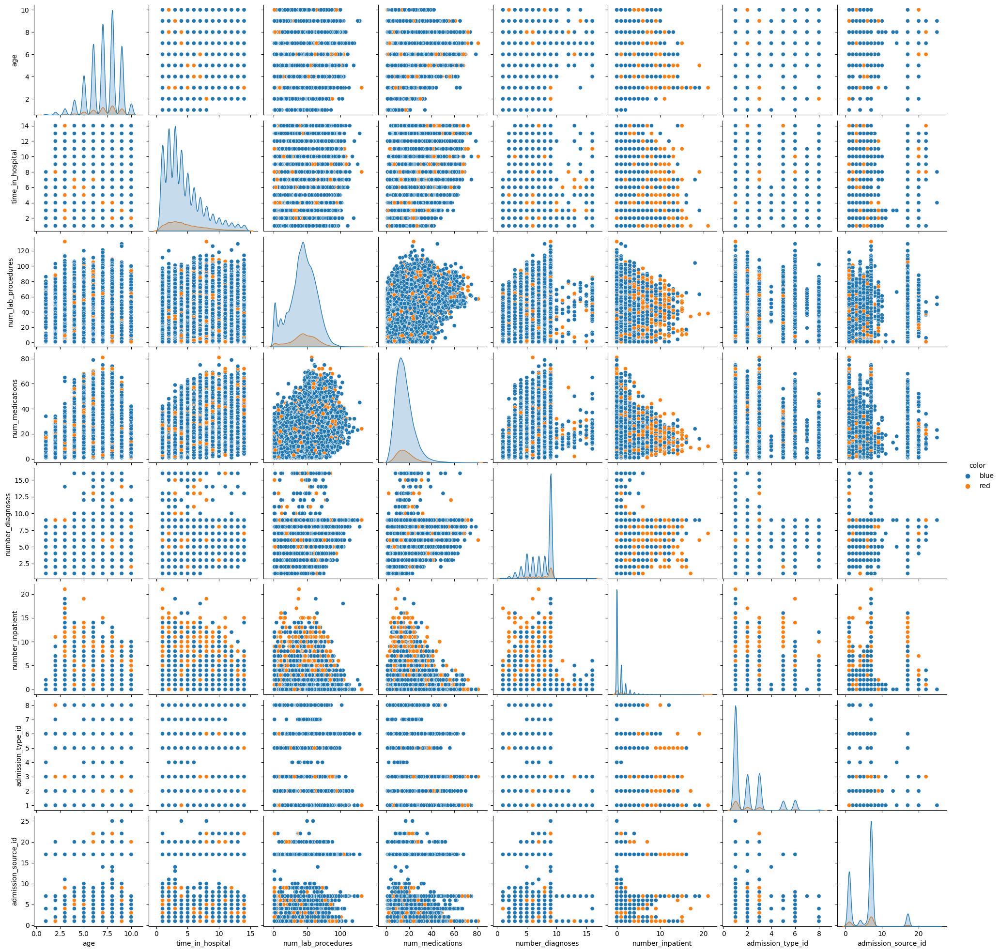

In [7]:
# Map readmitted values to colors
colors = {0: 'blue', 1: 'red'}
diabetes['color'] = diabetes['readmitted'].map(colors)

# Create pair plot with color mapping
sns.pairplot(data=diabetes, vars=['age', 'time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient', 'admission_type_id', 'admission_source_id'], hue='color')


In [17]:
import pandas as pd
import statsmodels.api as sm

# Create a binary variable for readmissions
diabetes["readmitted_binary"] = diabetes["readmitted"].apply(lambda x: 1 if x == 2 else 0)

# Create a logistic regression model
X = diabetes[["num_lab_procedures", "num_medications", 'number_inpatient']]
y = diabetes["readmitted_binary"]
X = sm.add_constant(X)
model = sm.Logit(y, X).fit()

# Print the results summary
print(model.summary())

Optimization terminated successfully.
         Current function value: 0.339232
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:      readmitted_binary   No. Observations:               101763
Model:                          Logit   Df Residuals:                   101759
Method:                           MLE   Df Model:                            3
Date:                Tue, 04 Apr 2023   Pseudo R-squ.:                 0.03036
Time:                        16:55:50   Log-Likelihood:                -34521.
converged:                       True   LL-Null:                       -35602.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -2.5365      0.029    -87.088      0.000      -2.594      -2.479
num_l

* coef : the coefficients of the independent variables in the regression equation.
* Log-Likelihood : the natural logarithm of the Maximum Likelihood Estimation(MLE) function. MLE is the optimization process of finding the set of parameters that result in the best fit.
* LL-Null : the value of log-likelihood of the model when no independent variable is included(only an intercept is included).
* Pseudo R-squ. : a substitute for the R-squared value in Least Squares linear regression. It is the ratio of the log-likelihood of the null model to that of the full model.
* Iterations‘ refer to the number of times the model iterates over the data, trying to optimize the model

## Multivariate analysis

#### LOS, Daignosis Codes, and Readmission <30 days 

In [1]:
#fig = px.scatter(diabetes[diabetes['readmitted'] == 1], x='time_in_hospital', y='diag_1', color='readmitted')
#fig.show()

# Breaking the data up into Train & Test

## column drops 

In [21]:
# Dropping the columns which are not required
diabetes.drop(['Unnamed: 0', 'encounter_id', 'patient_nbr', 'race', 'gender', 'age',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'medical_specialty',
       'num_procedures', 'number_outpatient',
       'number_emergency', 'diag_1', 'diag_2', 'diag_3',
       'max_glu_serum', 'A1Cresult', 'metformin',
       'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
       'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed'], axis = 1, inplace = True)

In [95]:
diabetes.head()

,time_in_hospital,num_lab_procedures,num_medications,number_inpatient,number_diagnoses,readmitted
0,1,41,1,0,1,0
1,3,59,18,0,9,0
2,2,11,13,1,6,0
3,2,44,16,0,7,0
4,1,51,8,0,5,0


In [22]:
train_df, valid_df, test_df = np.split(diabetes.sample(frac=1, random_state=42), 
                                       [int(.7*len(diabetes)), int(0.85*len(diabetes))])
train_df = train_df.reset_index(drop = True)
valid_df = valid_df.reset_index(drop = True)
test_df = test_df.reset_index(drop = True)

In [97]:
diabetes.readmitted.value_counts()

0    90406
1    11357
Name: readmitted, dtype: int64

In [98]:
train_df.readmitted.value_counts()

0    63219
1     8015
Name: readmitted, dtype: int64

In [99]:
valid_df.readmitted.value_counts()

0    13586
1     1678
Name: readmitted, dtype: int64

In [100]:
test_df.readmitted.value_counts()

0    13601
1     1664
Name: readmitted, dtype: int64

In [24]:
def calc_prevalence(y_actual):
    
    '''
    This function is to understand the ratio/distribution of the classes that we are going to predict for.
    
    Params:
    1. y_actual: The target feature
    
    Return:
    1. (sum(y_actual)/len(y_actual)): The ratio of the postive class in the comlpete data.
    '''
    
    return (sum(y_actual)/len(y_actual))

In [25]:
# split the training data into positive and negative
rows_pos = train_df.readmitted == 1
df_train_pos = train_df.loc[rows_pos]
df_train_neg = train_df.loc[~rows_pos]

# merge the balanced data
diabetes_df_balanced = pd.concat([df_train_pos, df_train_neg.sample(n = len(df_train_pos), random_state = 111)],axis = 0)

# shuffle the order of training samples 
diabetes_df_balanced = diabetes_df_balanced.sample(n = len(diabetes_df_balanced), random_state = 42).reset_index(drop = True)

print('Train balanced prevalence(n = %d):%.3f'%(len(diabetes_df_balanced), \
                                                calc_prevalence(diabetes_df_balanced.readmitted.values)))

Train balanced prevalence(n = 16030):0.500


In [26]:
diabetes_df_balanced.readmitted.value_counts()

1    8015
0    8015
Name: readmitted, dtype: int64

In [27]:
X_train = diabetes_df_balanced.drop('readmitted',axis=1)

y_train = diabetes_df_balanced['readmitted']

X_valid = valid_df.drop('readmitted',axis=1)

y_valid = valid_df['readmitted']

X_test = test_df.drop('readmitted',axis=1)

y_test = test_df['readmitted']

In [28]:
scaler=StandardScaler()
X_train[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']] = pd.DataFrame(scaler.fit_transform(X_train[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient'])
X_valid[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_valid[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient'])
X_test[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']] = pd.DataFrame(scaler.transform(X_test[['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']]),columns=['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient'])

In [29]:
def calc_specificity(y_actual, y_pred, thresh):
    # calculates specificity
    return sum((y_pred < thresh) & (y_actual == 0)) /sum(y_actual ==0)

def print_report(y_actual, y_pred, thresh = 0.5):
    
    '''
    This function calculates all the metrics to asses the machine learning models.
    
    Params:
    1. y_actual: The actual values for the target variable.
    2. y_pred: The predicted values for the target variable.
    3. thresh: The threshold for the probability to be considered as a positive class. Default value 0.5
    
    Return:
    1. AUC
    2. Accuracy
    3. Recall
    4. Precision
    5. Specificity
    '''
    
    auc = roc_auc_score(y_actual, y_pred)
    accuracy = accuracy_score(y_actual, (y_pred > thresh))
    recall = recall_score(y_actual, (y_pred > thresh))
    precision = precision_score(y_actual, (y_pred > thresh))
    specificity = calc_specificity(y_actual, y_pred, thresh)
    print('AUC:%.3f'%auc)
    print('accuracy:%.3f'%accuracy)
    print('recall:%.3f'%recall)
    print('precision:%.3f'%precision)
    print('specificity:%.3f'%specificity)
    print('prevalence:%.3f'%calc_prevalence(y_actual))
    print(' ')
    return auc, accuracy, recall, precision, specificity

In [30]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101763 entries, 0 to 101762
Data columns (total 6 columns):
 #   Column              Non-Null Count   Dtype
---  ------              --------------   -----
 0   time_in_hospital    101763 non-null  int64
 1   num_lab_procedures  101763 non-null  int64
 2   num_medications     101763 non-null  int64
 3   number_inpatient    101763 non-null  int64
 4   number_diagnoses    101763 non-null  int64
 5   readmitted          101763 non-null  int64
dtypes: int64(6)
memory usage: 4.7 MB


In [31]:
lnr = LinearRegression()
lnr.fit(X_train, y_train)


y_valid_preds = lnr.predict(X_valid)

In [32]:
y_valid_preds

array([0.32968764, 0.42345477, 0.44859354, ..., 0.44335355, 0.50297967,
       0.47447964])

In [33]:
lr=LogisticRegression(random_state = 42, solver = 'newton-cg', max_iter = 200)
lr.fit(X_train, y_train)

y_valid_preds = lr.predict_proba(X_valid)[:,1]

print('Metrics for Validation data:')

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,y_valid_preds, 0.5)

Metrics for Validation data:
AUC:0.625
accuracy:0.674
recall:0.466
precision:0.161
specificity:0.700
prevalence:0.110
 


In [34]:
knn = KNeighborsClassifier(n_neighbors = 100)
knn.fit(X_train, y_train)

knn_preds = knn.predict_proba(X_valid)[:,1]

lr_valid_auc, lr_valid_accuracy, lr_valid_recall, \
    lr_valid_precision, lr_valid_specificity = print_report(y_valid,knn_preds, 0.5)

AUC:0.614
accuracy:0.644
recall:0.489
precision:0.152
specificity:0.628
prevalence:0.110
 


# K mean and elbow 

In [8]:
# Step 1: Select relevant columns
features = ['age', 'gender', 'time_in_hospital', 'diag_1', 'diag_2', 'diag_3', 'num_medications', 'readmitted']

# Step 2: Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()
# Scale numerical features
num_cols = ['age', 'gender', 'time_in_hospital', 'num_medications']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])
# One-hot encode categorical features
cat_cols = ['diag_1', 'diag_2', 'diag_3', 'readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Step 3: Apply k-means clustering
from sklearn.cluster import KMeans
k = 4  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)

# Step 4: Evaluate clustering performance
from sklearn.metrics import silhouette_score
silhouette_score = silhouette_score(diabetes_encoded, cluster_labels)
print(f"Silhouette score: {silhouette_score}")

from sklearn.metrics import mean_squared_error
wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss}")

Silhouette score: 0.13139968639594934
Within-cluster sum of squares: 510489.824631853


Silhouette score: 0.13139968639594934
Within-cluster sum of squares: 510489.824631853


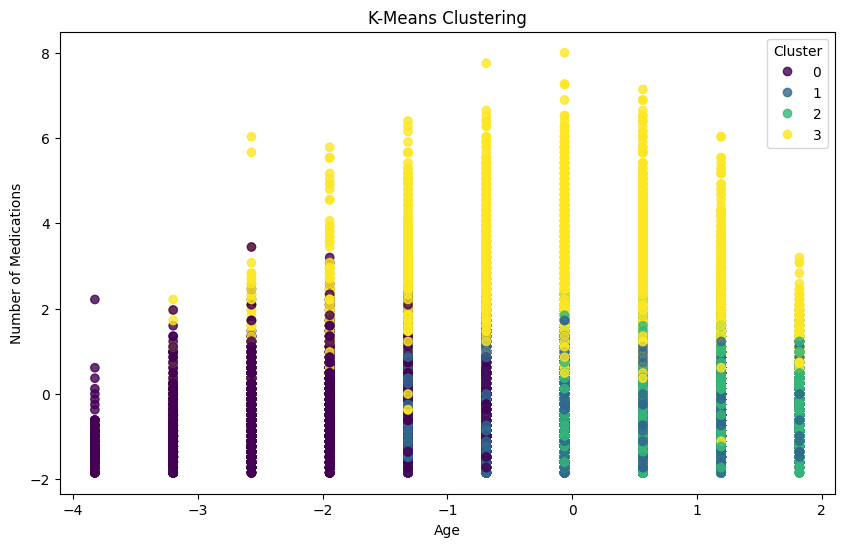

In [10]:
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

# Step 1: Select relevant columns
features = ['age', 'gender', 'time_in_hospital', 'diag_1', 'diag_2', 'diag_3', 'num_medications', 'readmitted']

# Step 2: Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()
# Scale numerical features
num_cols = ['age', 'gender', 'time_in_hospital', 'num_medications']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])
# One-hot encode categorical features
cat_cols = ['diag_1', 'diag_2', 'diag_3', 'readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Step 3: Apply k-means clustering
k = 4  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)
diabetes_encoded['cluster'] = cluster_labels

# Step 4: Evaluate clustering performance
silhouette_score = silhouette_score(diabetes_encoded.drop('cluster', axis=1), cluster_labels)
print(f"Silhouette score: {silhouette_score}")

wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss}")

# Step 5: Visualize clustering results
fig, ax = plt.subplots(figsize=(10,6))
scatter = ax.scatter(diabetes_encoded['age'], diabetes_encoded['num_medications'], c=cluster_labels, alpha=0.8)
plt.legend(*scatter.legend_elements(), title='Cluster')
ax.set_title('K-Means Clustering')
plt.show()


In [11]:
# Step 1: Select relevant columns
features = ['age', 'gender', 'time_in_hospital', 'diag_1', 'diag_2', 'diag_3', 'num_medications', 'readmitted']

# Step 2: Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()
# Scale numerical features
num_cols = ['age', 'gender', 'time_in_hospital', 'num_medications']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])
# One-hot encode categorical features
cat_cols = ['diag_1', 'diag_2', 'diag_3']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Separate patients that did and did not readmit
diabetes_readmitted = diabetes_encoded[diabetes_encoded['readmitted'] == 1]
diabetes_not_readmitted = diabetes_encoded[diabetes_encoded['readmitted'] == 0]

# Step 3: Apply k-means clustering
from sklearn.cluster import KMeans
k = 4  # number of clusters
kmeans_readmitted = KMeans(n_clusters=k, random_state=42)
kmeans_not_readmitted = KMeans(n_clusters=k, random_state=42)
readmitted_cluster_labels = kmeans_readmitted.fit_predict(diabetes_readmitted)
not_readmitted_cluster_labels = kmeans_not_readmitted.fit_predict(diabetes_not_readmitted)

# Step 4: Evaluate clustering performance
from sklearn.metrics import silhouette_score
silhouette_score_readmitted = silhouette_score(diabetes_readmitted, readmitted_cluster_labels)
silhouette_score_not_readmitted = silhouette_score(diabetes_not_readmitted, not_readmitted_cluster_labels)
print(f"Silhouette score for readmitted patients: {silhouette_score_readmitted}")
print(f"Silhouette score for not readmitted patients: {silhouette_score_not_readmitted}")

from sklearn.metrics import mean_squared_error
wss_readmitted = kmeans_readmitted.inertia_
wss_not_readmitted = kmeans_not_readmitted.inertia_
print(f"Within-cluster sum of squares for readmitted patients: {wss_readmitted}")
print(f"Within-cluster sum of squares for not readmitted patients: {wss_not_readmitted}")


Silhouette score for readmitted patients: 0.13774452174222496
Silhouette score for not readmitted patients: 0.13542501548395033
Within-cluster sum of squares for readmitted patients: 54745.13157479081
Within-cluster sum of squares for not readmitted patients: 435326.6860884105


In [13]:
import pandas as pd
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Step 1: Select relevant columns
features = ['age', 'time_in_hospital', 'gender', 'readmitted']

# Step 2: Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()
# Scale numerical features
num_cols = ['age', 'time_in_hospital', 'gender']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])
# One-hot encode categorical features
cat_cols = ['readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Step 3: Apply k-means clustering
k = 2  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)

# Step 4: Evaluate clustering performance
from sklearn.metrics import silhouette_score
silhouette_score = silhouette_score(diabetes_encoded, cluster_labels)
print(f"Silhouette score: {silhouette_score}")

from sklearn.metrics import mean_squared_error
wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss}")

# Step 5: Visualize the scatter plot with clusters
diabetes_encoded['cluster'] = cluster_labels
fig = px.scatter(diabetes_encoded, title= 'K Mean', color='cluster')
fig.show()


Silhouette score: 0.3530471696679011
Within-cluster sum of squares: 223353.6145312196


Silhouette score: 0.193
Within-cluster sum of squares: 261680.985


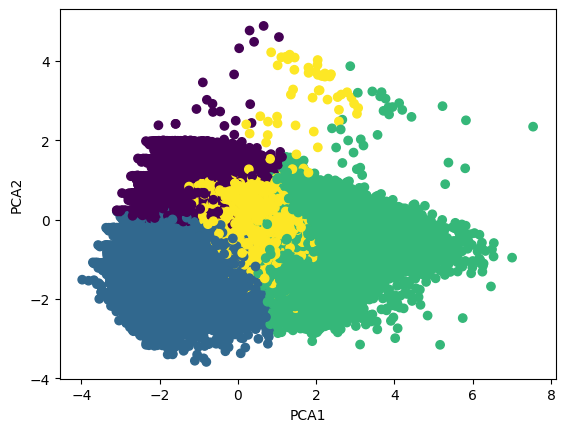

In [15]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import pandas as pd
import matplotlib.pyplot as plt

# Select relevant columns
features = ['gender', 'time_in_hospital', 'num_lab_procedures', 'number_diagnoses', 'num_medications', 'readmitted']

# Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()

# Scale numerical features
num_cols = ['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])

# One-hot encode categorical features
cat_cols = ['gender', 'readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Apply k-means clustering
k = 4  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)

# Compute Silhouette score
silhouette_avg = silhouette_score(diabetes_encoded, cluster_labels)
print(f"Silhouette score: {silhouette_avg:.3f}")

# Compute WSS
wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss:.3f}")
# PCA for dimensionality reduction
pca = PCA(n_components=2)
pca_features = pca.fit_transform(diabetes_encoded)

# Plot the scatter plot
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=cluster_labels)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()


# ELBOW GRAPH TO FIND K VALUE 

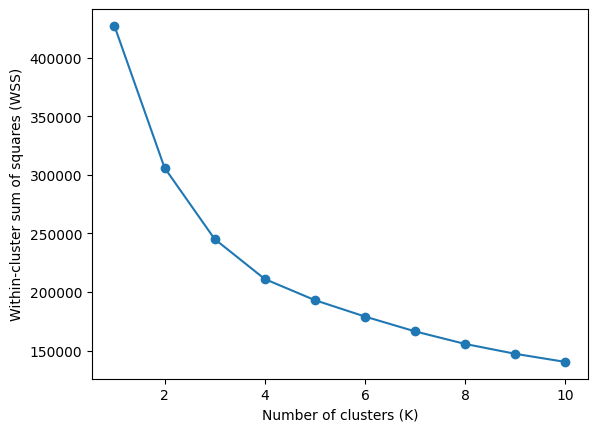

In [17]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import matplotlib.pyplot as plt

# Select relevant columns
features = ['time_in_hospital', 'num_lab_procedures', 'number_diagnoses', 'num_medications', 'readmitted']

# Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()

# Scale numerical features
num_cols = ['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])

# One-hot encode categorical features
cat_cols = ['readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Determine optimal number of clusters using elbow method
wss = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(diabetes_encoded)
    wss.append(kmeans.inertia_)

# Plot the elbow graph
plt.plot(range(1, 11), wss, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Within-cluster sum of squares (WSS)')
plt.show()

# BEST SCORE SO FAR

Silhouette score: 0.231
Within-cluster sum of squares: 211100.024


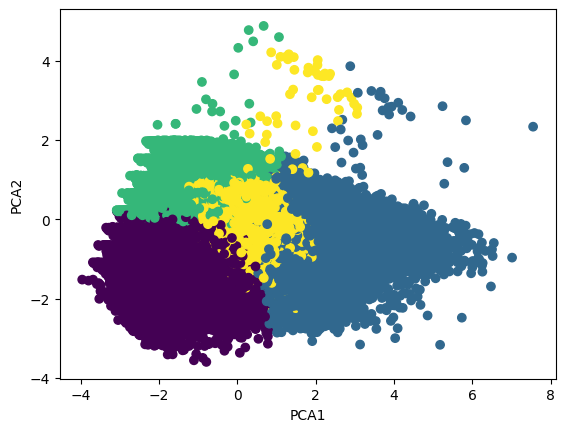

In [16]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import pandas as pd
import matplotlib.pyplot as plt

# Select relevant columns
features = ['time_in_hospital', 'num_lab_procedures', 'number_diagnoses', 'num_medications', 'readmitted']

# Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()

# Scale numerical features
num_cols = ['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])

# One-hot encode categorical features
cat_cols = ['readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Apply k-means clustering
k = 4  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)

# Compute Silhouette score
silhouette_avg = silhouette_score(diabetes_encoded, cluster_labels)
print(f"Silhouette score: {silhouette_avg:.3f}")

# Compute WSS
wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss:.3f}")
# PCA for dimensionality reduction
pca = PCA(n_components=2)
pca_features = pca.fit_transform(diabetes_encoded)

# Plot the scatter plot
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=cluster_labels)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()

Silhouette score: 0.250
Within-cluster sum of squares: 245211.248


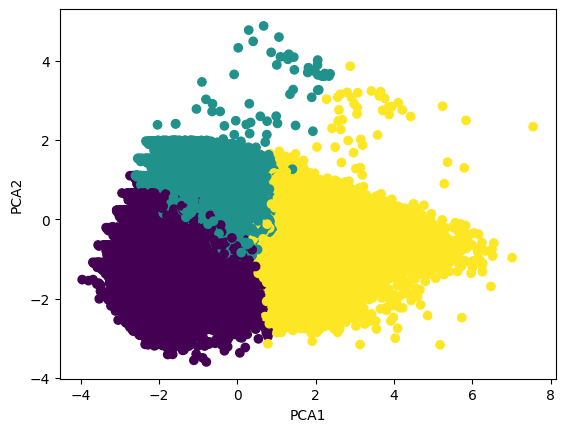

In [18]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import pandas as pd
import matplotlib.pyplot as plt

# Select relevant columns
features = ['time_in_hospital', 'num_lab_procedures', 'number_diagnoses', 'num_medications', 'readmitted']

# Data preprocessing
# Handle missing values
diabetes_clean = diabetes[features].dropna()

# Scale numerical features
num_cols = ['time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses']
scaler = StandardScaler()
diabetes_clean[num_cols] = scaler.fit_transform(diabetes_clean[num_cols])

# One-hot encode categorical features
cat_cols = ['readmitted']
diabetes_encoded = pd.get_dummies(diabetes_clean, columns=cat_cols)

# Apply k-means clustering
k = 3  # number of clusters
kmeans = KMeans(n_clusters=k, random_state=42)
cluster_labels = kmeans.fit_predict(diabetes_encoded)

# Compute Silhouette score
silhouette_avg = silhouette_score(diabetes_encoded, cluster_labels)
print(f"Silhouette score: {silhouette_avg:.3f}")

# Compute WSS
wss = kmeans.inertia_
print(f"Within-cluster sum of squares: {wss:.3f}")
# PCA for dimensionality reduction
pca = PCA(n_components=2)
pca_features = pca.fit_transform(diabetes_encoded)

# Plot the scatter plot
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=cluster_labels)
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()